In [1]:
import os
import sys
import matplotlib.pyplot as plt
clipstyler_dir = os.path.join("/content", "clipstyler")

!pip install ftfy regex tqdm
!pip install git+https://github.com/openai/CLIP.git
!git clone https://github.com/paper11667/CLIPstyler/ $clipstyler_dir
sys.path.append(clipstyler_dir)

from PIL import Image
import numpy as np
import sys
import torch
import torch.nn
import torch.optim as optim
from torchvision import transforms, models

import StyleNet
import utils
import clip
import torch.nn.functional as F
from template import imagenet_templates

from PIL import Image
import PIL
from torchvision import utils as vutils
import argparse
from torchvision.transforms.functional import adjust_contrast

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.4/54.4 kB 1.0 MB/s eta 0:00:00
  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-a_vf4qn4
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-a_vf4qn4
  Resolved https://github.com/openai/CLIP.git to commit a1d071733d7111c9c014f024669f959182114e33
  Preparing metadata (setup.py) ... done
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_

In [2]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [3]:

# VGG = models.vgg19(pretrained=True).features
# VGG.to(device)

# for parameter in VGG.parameters():
#     parameter.requires_grad_(False)

def img_denormalize(image):
    mean=torch.tensor([0.485, 0.456, 0.406]).to(device)
    std=torch.tensor([0.229, 0.224, 0.225]).to(device)
    mean = mean.view(1,-1,1,1)
    std = std.view(1,-1,1,1)

    image = image*std +mean
    return image

def img_normalize(image):
    mean=torch.tensor([0.485, 0.456, 0.406]).to(device)
    std=torch.tensor([0.229, 0.224, 0.225]).to(device)
    mean = mean.view(1,-1,1,1)
    std = std.view(1,-1,1,1)

    image = (image-mean)/std
    return image

def clip_normalize(image,device):
    image = F.interpolate(image,size=224,mode='bicubic')
    mean=torch.tensor([0.48145466, 0.4578275, 0.40821073]).to(device)
    std=torch.tensor([0.26862954, 0.26130258, 0.27577711]).to(device)
    mean = mean.view(1,-1,1,1)
    std = std.view(1,-1,1,1)

    image = (image-mean)/std
    return image


def get_image_prior_losses(inputs_jit):
    diff1 = inputs_jit[:, :, :, :-1] - inputs_jit[:, :, :, 1:]
    diff2 = inputs_jit[:, :, :-1, :] - inputs_jit[:, :, 1:, :]
    diff3 = inputs_jit[:, :, 1:, :-1] - inputs_jit[:, :, :-1, 1:]
    diff4 = inputs_jit[:, :, :-1, :-1] - inputs_jit[:, :, 1:, 1:]

    loss_var_l2 = torch.norm(diff1) + torch.norm(diff2) + torch.norm(diff3) + torch.norm(diff4)

    return loss_var_l2

In [4]:
resnet152 = models.resnet152(pretrained=True)
modules=list(resnet152.children())[:-1]
resnet152=torch.nn.Sequential(*modules)
for p in resnet152.parameters():
    p.requires_grad = False

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet152_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet152_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet152-394f9c45.pth" to /root/.cache/torch/hub/checkpoints/resnet152-394f9c45.pth
100%|██████████| 230M/230M [00:01<00:00, 140MB/s]


In [5]:
resnet152.to(device)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)


In [6]:
# you will be prompted with a window asking to grant permissions
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [7]:
# fill in the path in your Google Drive in the string below. Note: do not escape slashes or spaces
import os
datadir = "/content/CS444_sp24_code"
if not os.path.exists(datadir):
  !ln -s "/content/drive/My Drive/CS444_sp24_code" $datadir # TODO: Fill your Assignment 4 path
os.chdir(datadir)
!pwd

/content/drive/.shortcut-targets-by-id/1O6lf72x2O4rcW43Bsb2H1u0NOxcNuEmT/CS444_sp24_code


In [8]:
import os

def list_jpg_files(directory):
    files = os.listdir(directory)
    jpg_files = [file for file in files if file.endswith('.png')]
    return jpg_files

directory_path = './train_data'
jpg_files = list_jpg_files(directory_path)
print(jpg_files)


['0017x4.png', '0004x4.png', '0029x4.png', '0019x4.png', '0030x4.png', '0009x4.png', '0012x4.png', '0010x4.png', '0018x4.png', '0006x4.png', '0025x4.png', '0023x4.png', '0027x4.png', '0031x4.png', '0014x4.png', '0011x4.png', '0007x4.png', '0028x4.png', '0015x4.png', '0026x4.png', '0016x4.png', '0001x4.png', '0002x4.png', '0022x4.png', '0005x4.png', '0003x4.png', '0024x4.png', '0021x4.png', '0020x4.png', '0013x4.png', '0008x4.png', '0067x4.png', '0099x4.png', '0065x4.png', '0125x4.png', '0041x4.png', '0051x4.png', '0056x4.png', '0042x4.png', '0074x4.png', '0064x4.png', '0077x4.png', '0095x4.png', '0038x4.png', '0083x4.png', '0036x4.png', '0035x4.png', '0058x4.png', '0068x4.png', '0039x4.png', '0061x4.png', '0047x4.png', '0123x4.png', '0092x4.png', '0043x4.png', '0120x4.png', '0119x4.png', '0079x4.png', '0040x4.png', '0045x4.png', '0087x4.png', '0066x4.png', '0076x4.png', '0096x4.png', '0088x4.png', '0052x4.png', '0062x4.png', '0109x4.png', '0091x4.png', '0122x4.png', '0111x4.png', '0034

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:143: UserWarning: Detected call of `lr_scheduler.step()` before `optimizer.step()`. In PyTorch 1.1.0 and later, you should call them in the opposite order: `optimizer.step()` before `lr_scheduler.step()`.  Failure to do this will result in PyTorch skipping the first value of the learning rate schedule. See more details at https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate
  warnings.warn("Detected call of `lr_scheduler.step()` before `optimizer.step()`. "


After 100 iters:
Total loss:  6665.15380859375
Content loss:  -0.025496186688542366
patch loss:  0.72265625
dir loss:  0.3291015625
TV loss:  0.4781394898891449
prompt : pencil Sketch


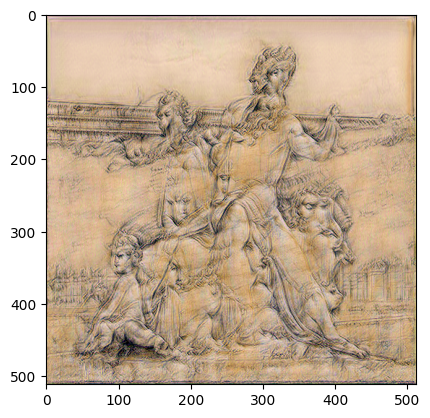

After 100 iters:
Total loss:  5563.96337890625
Content loss:  -0.03830455243587494
patch loss:  0.599609375
dir loss:  0.34619140625
TV loss:  0.5841256380081177
prompt : fire


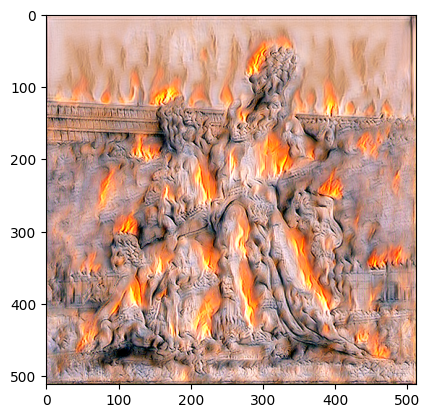

After 100 iters:
Total loss:  1444.52734375
Content loss:  -0.1743357926607132
patch loss:  0.1463623046875
dir loss:  0.30615234375
TV loss:  0.5527783036231995
prompt : neon light


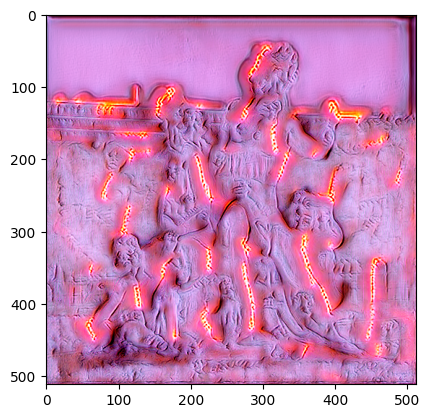

After 100 iters:
Total loss:  6561.4287109375
Content loss:  -0.23263894021511078
patch loss:  0.71240234375
dir loss:  0.3671875
TV loss:  0.6999171376228333
prompt : pop themed nightlife


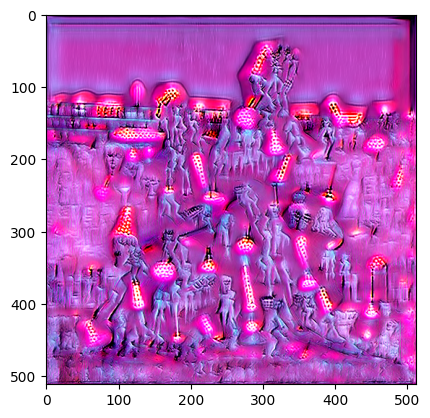

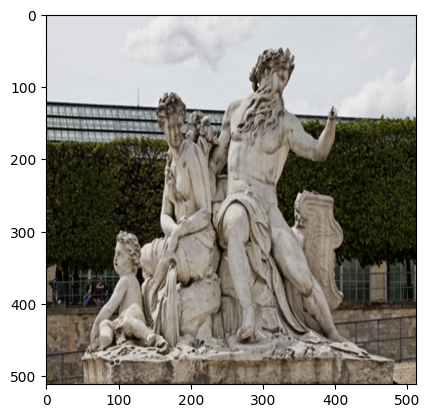

--------------------------

After 100 iters:
Total loss:  7412.458984375
Content loss:  -0.03870200365781784
patch loss:  0.7890625
dir loss:  0.6357421875
TV loss:  0.5143258571624756
prompt : pencil Sketch


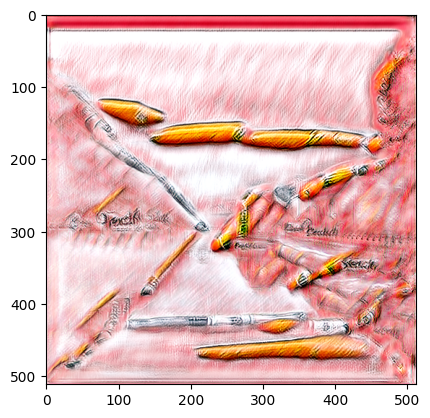

After 100 iters:
Total loss:  6811.61328125
Content loss:  0.0008145496249198914
patch loss:  0.72705078125
dir loss:  0.5341796875
TV loss:  0.49132582545280457
prompt : fire


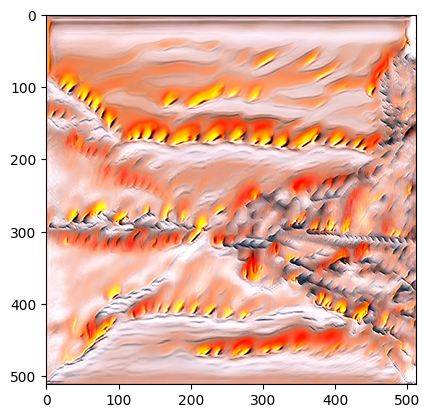

After 100 iters:
Total loss:  3395.105224609375
Content loss:  -0.05035513639450073
patch loss:  0.344482421875
dir loss:  0.6044921875
TV loss:  0.4084802567958832
prompt : neon light


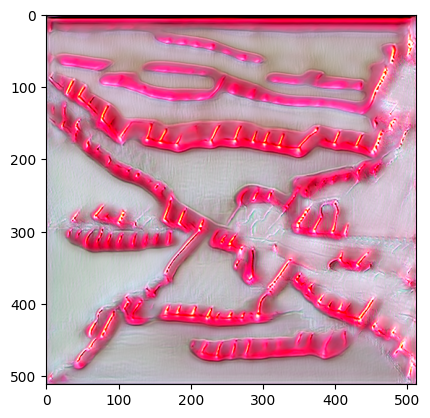

After 100 iters:
Total loss:  7119.67919921875
Content loss:  -0.15218009054660797
patch loss:  0.7607421875
dir loss:  0.587890625
TV loss:  0.5065568089485168
prompt : pop themed nightlife


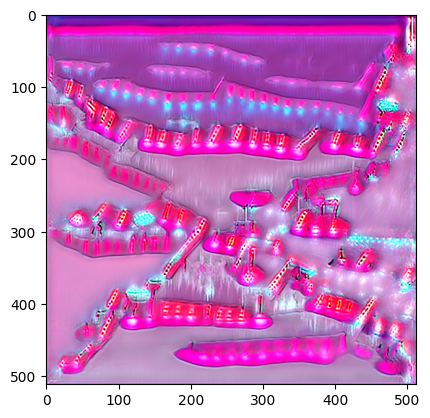

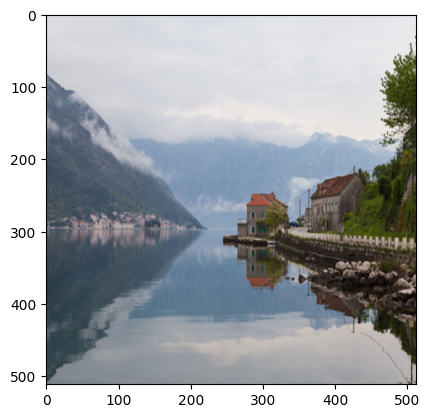

--------------------------

After 100 iters:
Total loss:  6998.708984375
Content loss:  -0.13862720131874084
patch loss:  0.7490234375
dir loss:  0.5576171875
TV loss:  0.7527307271957397
prompt : pencil Sketch


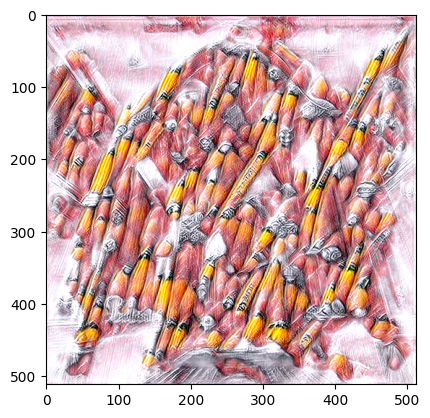

After 100 iters:
Total loss:  6861.52490234375
Content loss:  -0.051953040063381195
patch loss:  0.73681640625
dir loss:  0.47265625
TV loss:  0.9428240656852722
prompt : fire


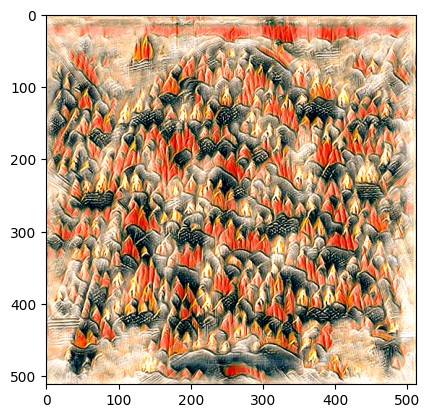

After 100 iters:
Total loss:  7018.93310546875
Content loss:  -0.1448971927165985
patch loss:  0.755859375
dir loss:  0.4716796875
TV loss:  0.7923915386199951
prompt : neon light


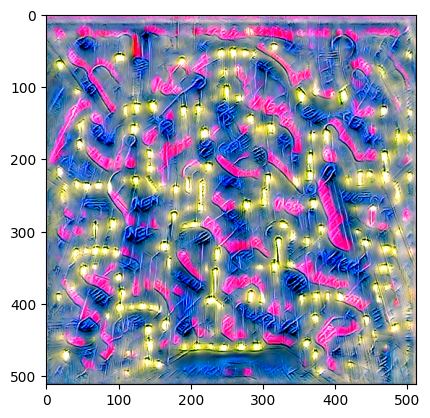

After 100 iters:
Total loss:  4119.81103515625
Content loss:  -0.2584710121154785
patch loss:  0.439697265625
dir loss:  0.3994140625
TV loss:  0.8317552804946899
prompt : pop themed nightlife


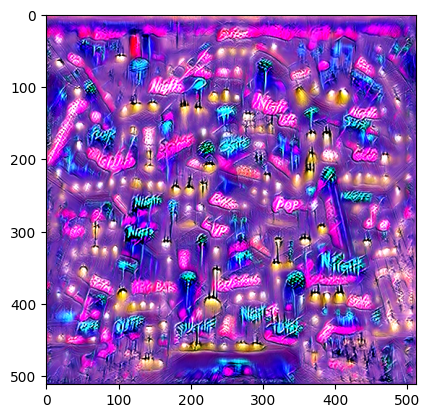

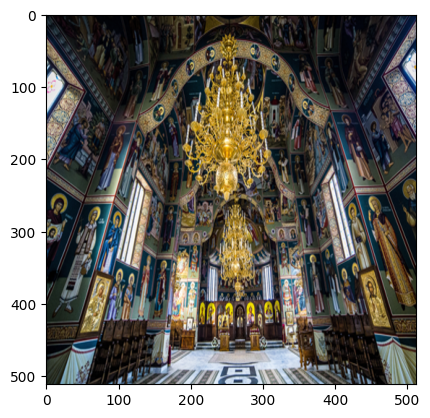

--------------------------

After 100 iters:
Total loss:  375.4389343261719
Content loss:  -0.12489727139472961
patch loss:  0.022308349609375
dir loss:  0.38525390625
TV loss:  0.7985305786132812
prompt : pencil Sketch


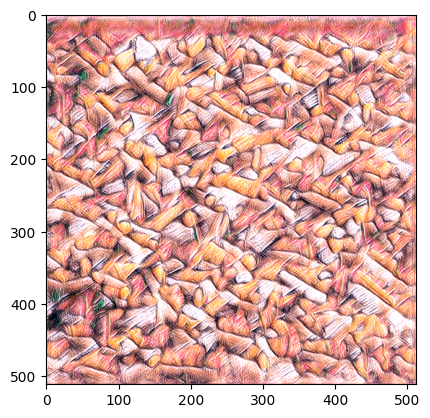

After 100 iters:
Total loss:  7010.90087890625
Content loss:  -0.07210090011358261
patch loss:  0.75
dir loss:  0.53759765625
TV loss:  0.9657976031303406
prompt : fire


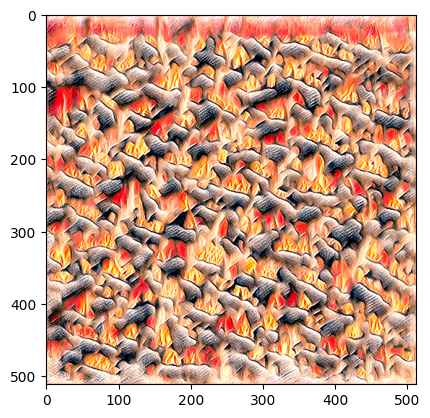

After 100 iters:
Total loss:  2709.833984375
Content loss:  -0.18662770092487335
patch loss:  0.277587890625
dir loss:  0.47802734375
TV loss:  0.8281945586204529
prompt : neon light


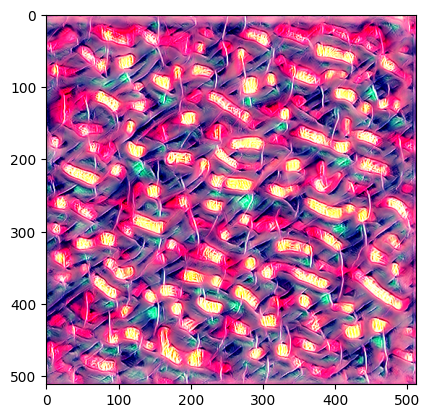

After 100 iters:
Total loss:  2513.017333984375
Content loss:  -0.2898070216178894
patch loss:  0.2568359375
dir loss:  0.4873046875
TV loss:  0.8632590770721436
prompt : pop themed nightlife


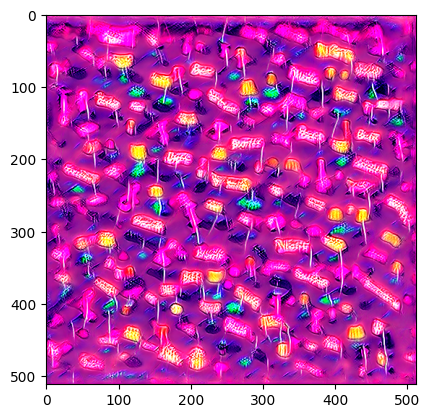

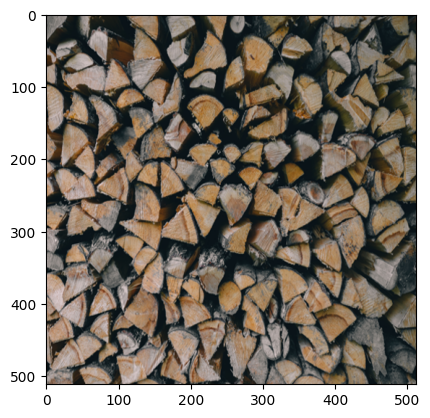

--------------------------

After 100 iters:
Total loss:  6840.47998046875
Content loss:  -0.10179132968187332
patch loss:  0.732421875
dir loss:  0.52587890625
TV loss:  0.7483939528465271
prompt : pencil Sketch


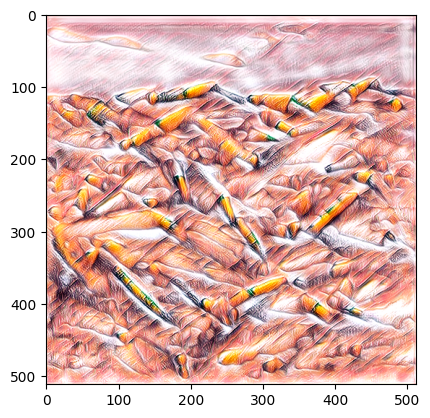

After 100 iters:
Total loss:  3095.0517578125
Content loss:  -0.09087292850017548
patch loss:  0.322021484375
dir loss:  0.41943359375
TV loss:  0.9325867295265198
prompt : fire


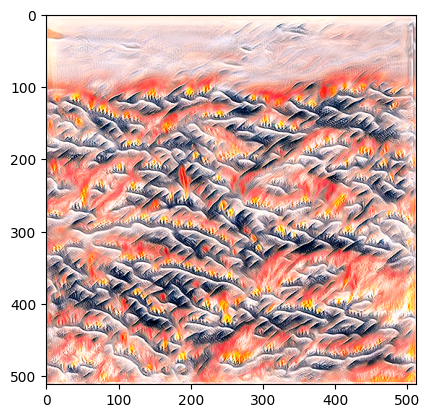

After 100 iters:
Total loss:  3284.085205078125
Content loss:  -0.20668387413024902
patch loss:  0.34423828125
dir loss:  0.4326171875
TV loss:  0.8379008769989014
prompt : neon light


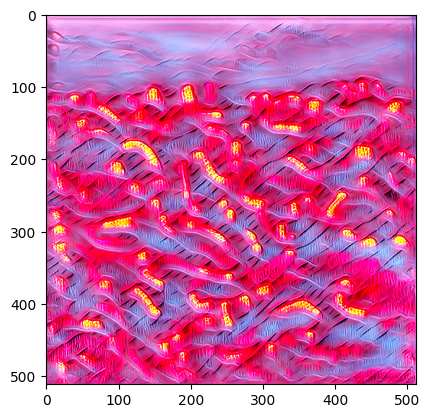

After 100 iters:
Total loss:  4001.51025390625
Content loss:  -0.23434293270111084
patch loss:  0.4228515625
dir loss:  0.45947265625
TV loss:  0.9117078185081482
prompt : pop themed nightlife


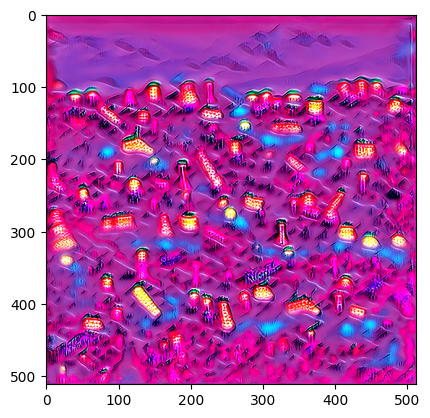

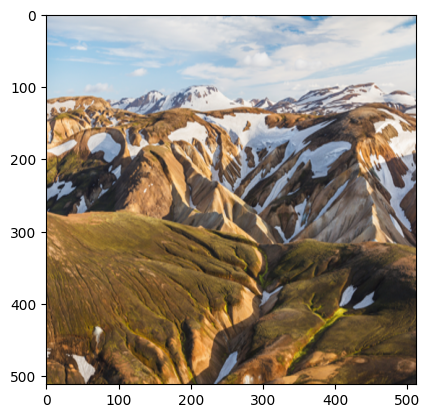

--------------------------

After 100 iters:
Total loss:  6913.14453125
Content loss:  -0.05799204856157303
patch loss:  0.73583984375
dir loss:  0.59375
TV loss:  0.843133807182312
prompt : pencil Sketch


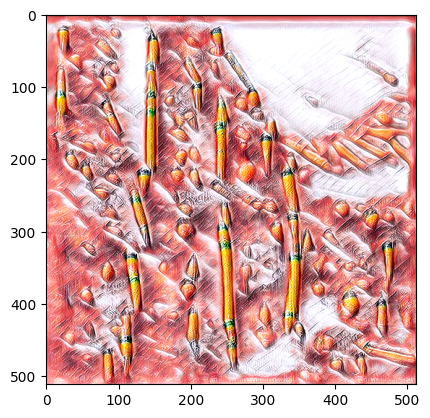

After 100 iters:
Total loss:  6523.76220703125
Content loss:  0.0030631041154265404
patch loss:  0.693359375
dir loss:  0.564453125
TV loss:  1.0528836250305176
prompt : fire


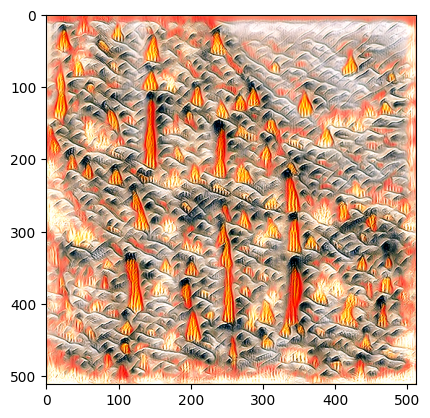

After 100 iters:
Total loss:  5541.6513671875
Content loss:  -0.08972015231847763
patch loss:  0.58349609375
dir loss:  0.6044921875
TV loss:  0.8592522144317627
prompt : neon light


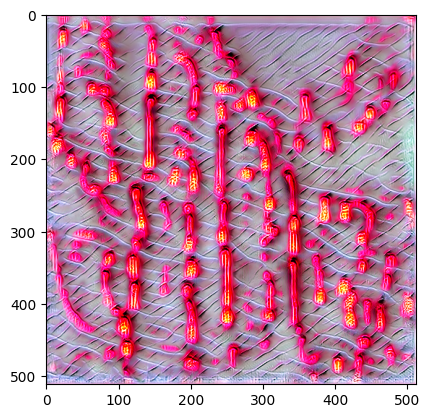

After 100 iters:
Total loss:  4868.7353515625
Content loss:  -0.15693029761314392
patch loss:  0.5166015625
dir loss:  0.48681640625
TV loss:  0.9000347256660461
prompt : pop themed nightlife


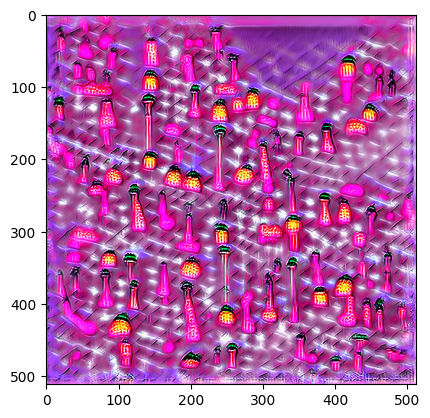

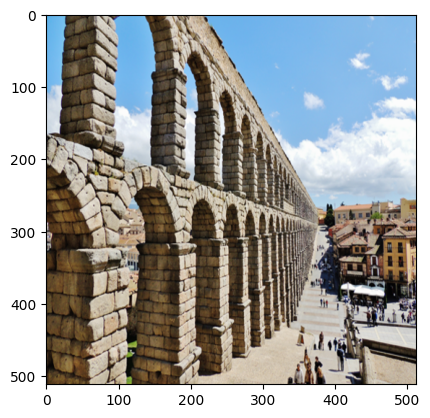

--------------------------

After 100 iters:
Total loss:  6856.7861328125
Content loss:  -0.1304716020822525
patch loss:  0.73095703125
dir loss:  0.5908203125
TV loss:  0.8567368984222412
prompt : pencil Sketch


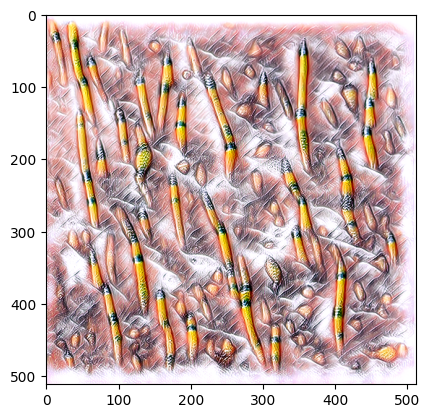

After 100 iters:
Total loss:  1713.49072265625
Content loss:  -0.12606824934482574
patch loss:  0.16552734375
dir loss:  0.48291015625
TV loss:  0.9009743928909302
prompt : fire


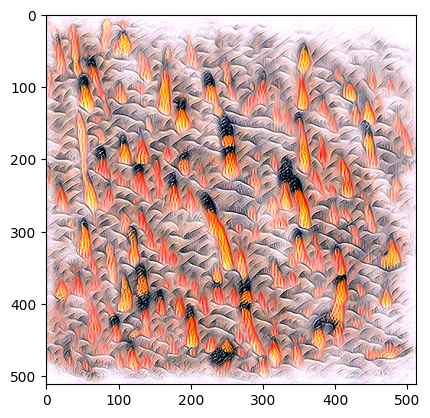

After 100 iters:
Total loss:  6836.81787109375
Content loss:  -0.17307324707508087
patch loss:  0.72998046875
dir loss:  0.587890625
TV loss:  0.7790479063987732
prompt : neon light


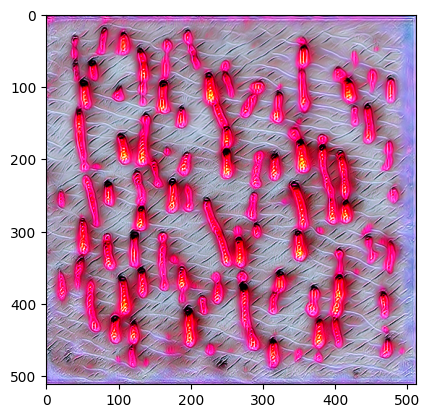

After 100 iters:
Total loss:  2928.657470703125
Content loss:  -0.218512624502182
patch loss:  0.29931640625
dir loss:  0.533203125
TV loss:  0.9344204664230347
prompt : pop themed nightlife


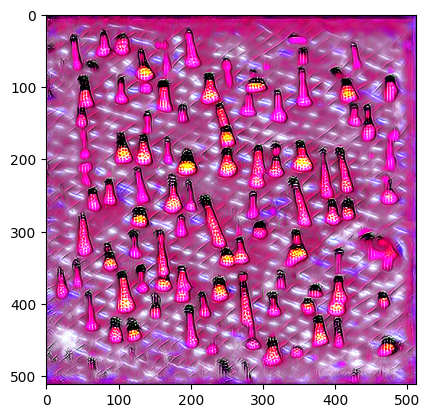

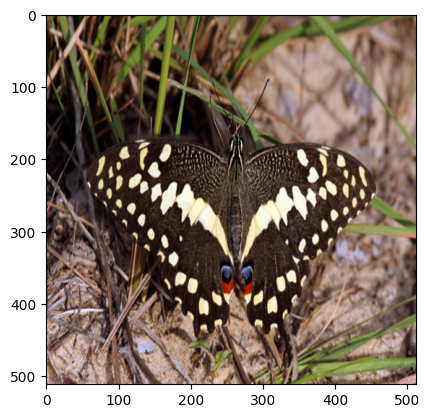

--------------------------

After 100 iters:
Total loss:  7161.97998046875
Content loss:  -0.1486317366361618
patch loss:  0.76318359375
dir loss:  0.630859375
TV loss:  0.7750360369682312
prompt : pencil Sketch


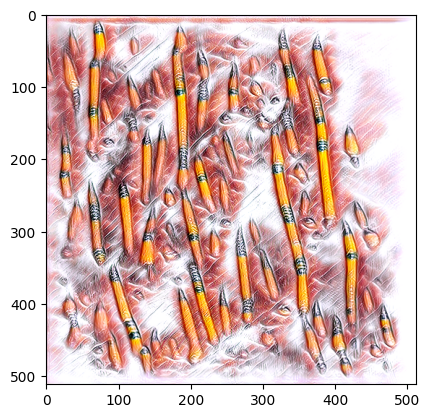

After 100 iters:
Total loss:  1708.510009765625
Content loss:  -0.1349070817232132
patch loss:  0.1654052734375
dir loss:  0.47802734375
TV loss:  0.7461333274841309
prompt : fire


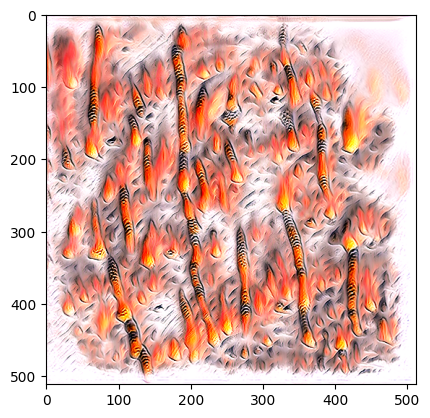

After 100 iters:
Total loss:  1607.894287109375
Content loss:  -0.21023187041282654
patch loss:  0.154296875
dir loss:  0.49951171875
TV loss:  0.6790956258773804
prompt : neon light


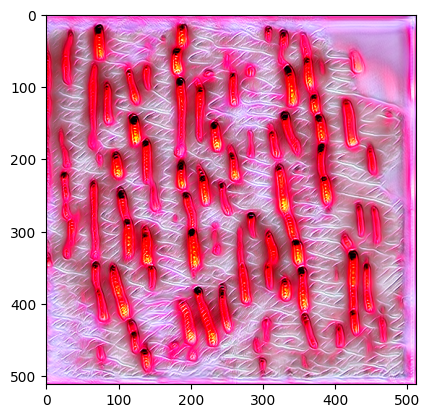

After 100 iters:
Total loss:  1378.9549560546875
Content loss:  -0.3130231499671936
patch loss:  0.133056640625
dir loss:  0.4541015625
TV loss:  0.9084903001785278
prompt : pop themed nightlife


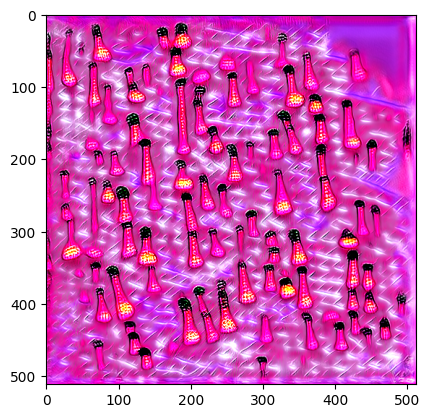

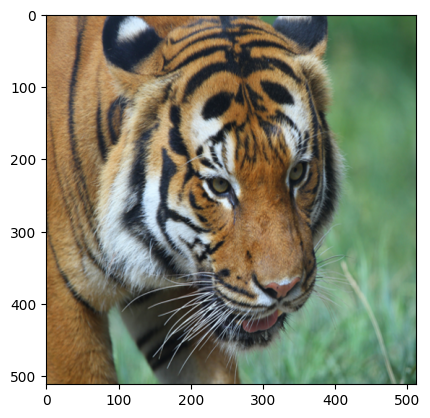

--------------------------

After 100 iters:
Total loss:  6339.0732421875
Content loss:  -0.1445963829755783
patch loss:  0.673828125
dir loss:  0.591796875
TV loss:  0.762509286403656
prompt : pencil Sketch


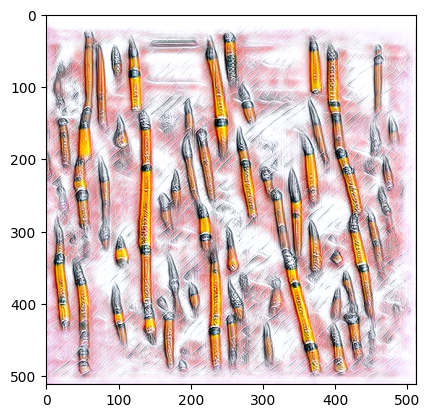

After 100 iters:
Total loss:  3137.15625
Content loss:  -0.11355535686016083
patch loss:  0.32080078125
dir loss:  0.5302734375
TV loss:  0.9394448399543762
prompt : fire


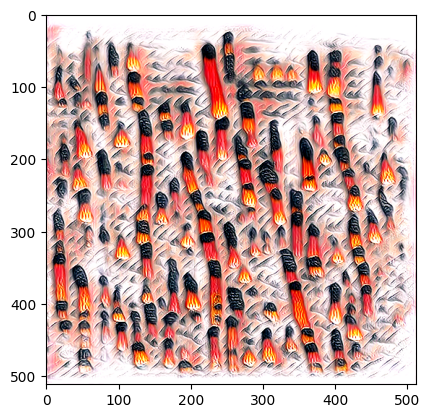

After 100 iters:
Total loss:  3644.935302734375
Content loss:  -0.15499988198280334
patch loss:  0.378173828125
dir loss:  0.5263671875
TV loss:  0.935301661491394
prompt : neon light


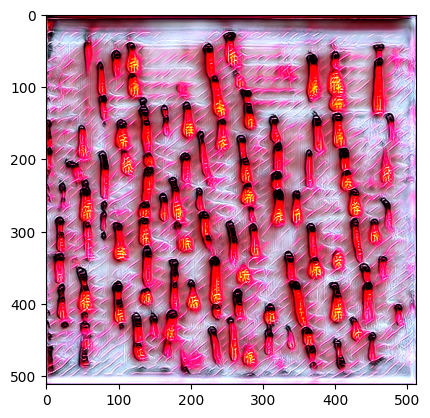

After 100 iters:
Total loss:  7132.57373046875
Content loss:  -0.12193155288696289
patch loss:  0.7607421875
dir loss:  0.603515625
TV loss:  1.113175630569458
prompt : pop themed nightlife


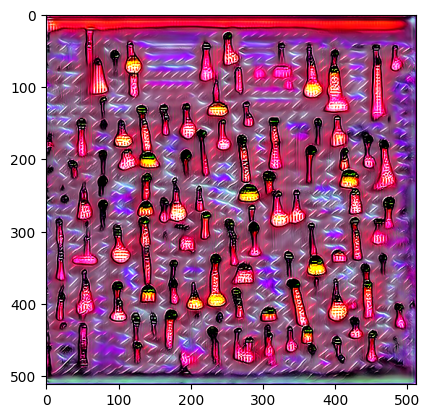

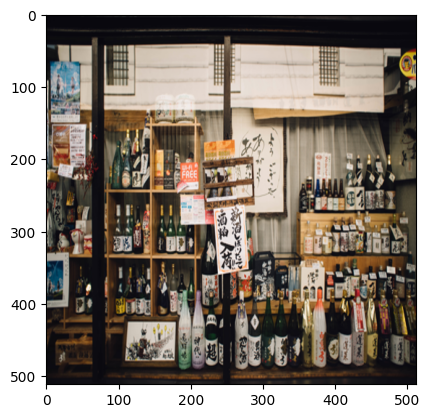

--------------------------

After 100 iters:
Total loss:  6776.68798828125
Content loss:  -0.22604097425937653
patch loss:  0.72021484375
dir loss:  0.65966796875
TV loss:  0.8441118001937866
prompt : pencil Sketch


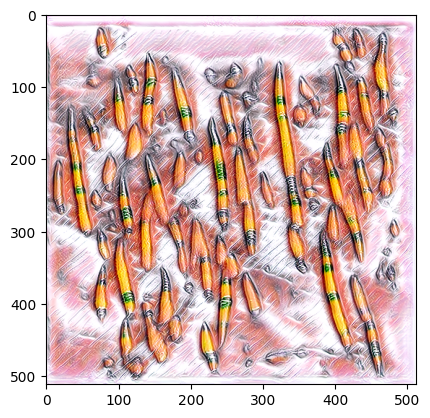

After 100 iters:
Total loss:  830.8781127929688
Content loss:  -0.19763173162937164
patch loss:  0.0665283203125
dir loss:  0.521484375
TV loss:  0.7728923559188843
prompt : fire


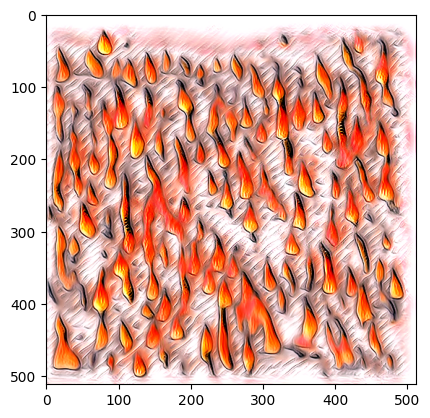

After 100 iters:
Total loss:  2026.5438232421875
Content loss:  -0.28955838084220886
patch loss:  0.1990966796875
dir loss:  0.5546875
TV loss:  0.7274968028068542
prompt : neon light


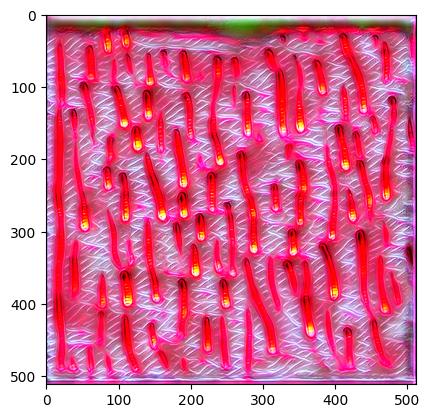

After 100 iters:
Total loss:  1679.43603515625
Content loss:  -0.34363770484924316
patch loss:  0.165771484375
dir loss:  0.47607421875
TV loss:  0.9816625714302063
prompt : pop themed nightlife


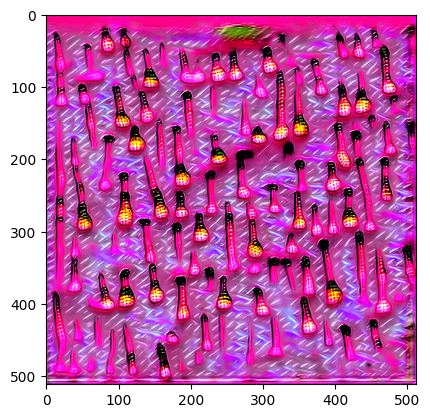

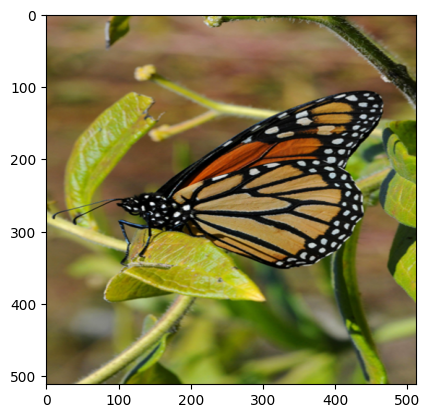

--------------------------

After 100 iters:
Total loss:  5979.685546875
Content loss:  -0.11236730217933655
patch loss:  0.63037109375
dir loss:  0.6474609375
TV loss:  0.7907018065452576
prompt : pencil Sketch


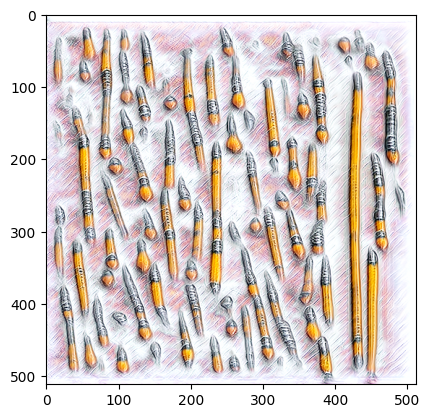

After 100 iters:
Total loss:  5317.4609375
Content loss:  -0.08928831666707993
patch loss:  0.55712890625
dir loss:  0.6279296875
TV loss:  0.8542109131813049
prompt : fire


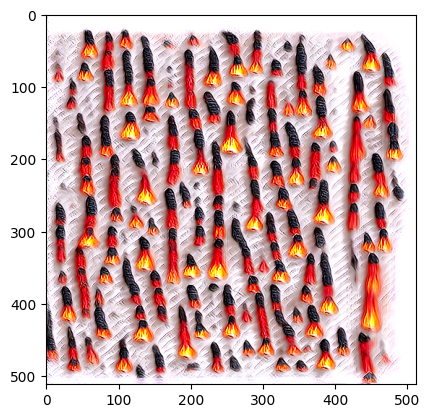

After 100 iters:
Total loss:  6706.5185546875
Content loss:  -0.11946380883455276
patch loss:  0.71240234375
dir loss:  0.623046875
TV loss:  0.938068687915802
prompt : neon light


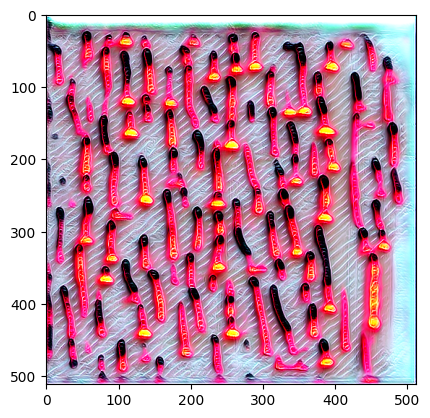

After 100 iters:
Total loss:  7158.3525390625
Content loss:  -0.08657785505056381
patch loss:  0.763671875
dir loss:  0.5966796875
TV loss:  1.0892207622528076
prompt : pop themed nightlife


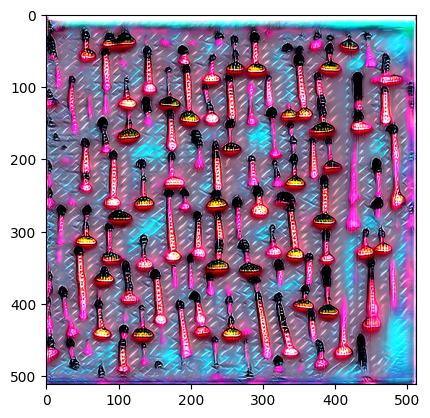

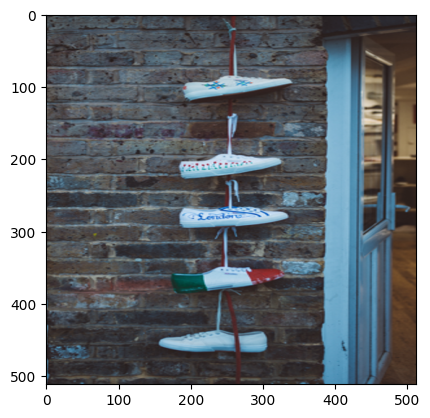

--------------------------

After 100 iters:
Total loss:  6178.80078125
Content loss:  -0.17329436540603638
patch loss:  0.65283203125
dir loss:  0.65576171875
TV loss:  0.7948374152183533
prompt : pencil Sketch


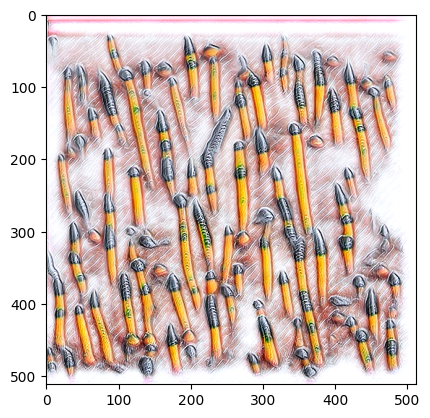

After 100 iters:
Total loss:  1257.967529296875
Content loss:  -0.14206726849079132
patch loss:  0.11077880859375
dir loss:  0.56298828125
TV loss:  0.7776481509208679
prompt : fire


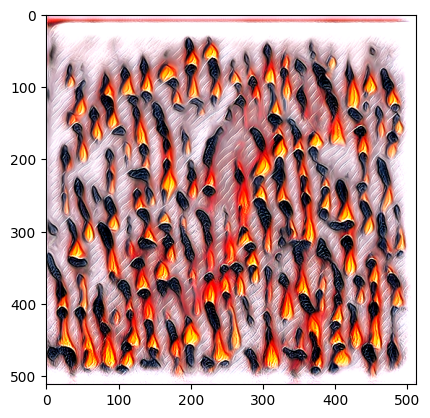

After 100 iters:
Total loss:  1890.02734375
Content loss:  -0.22703760862350464
patch loss:  0.177734375
dir loss:  0.646484375
TV loss:  0.8329503536224365
prompt : neon light


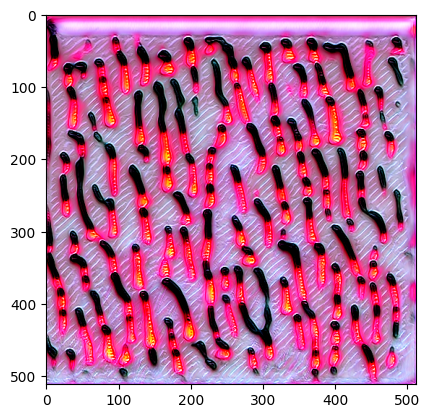

After 100 iters:
Total loss:  2474.6044921875
Content loss:  -0.2698184549808502
patch loss:  0.2447509765625
dir loss:  0.6240234375
TV loss:  1.0772480964660645
prompt : pop themed nightlife


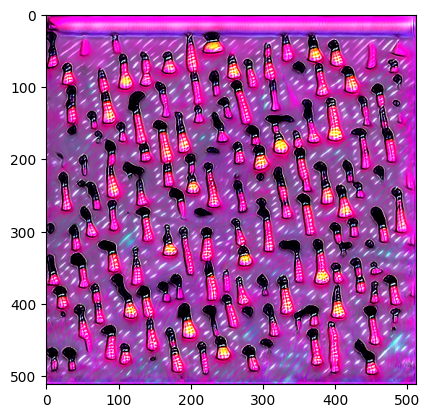

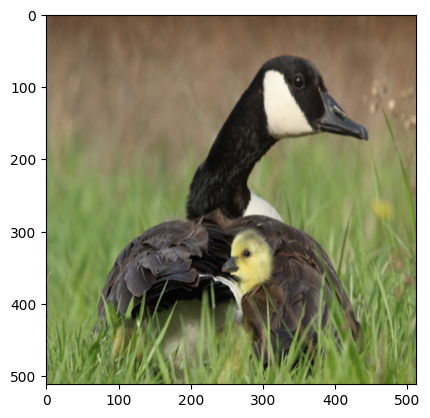

--------------------------

After 100 iters:
Total loss:  6861.98681640625
Content loss:  -0.13259060680866241
patch loss:  0.72705078125
dir loss:  0.673828125
TV loss:  0.8753162622451782
prompt : pencil Sketch


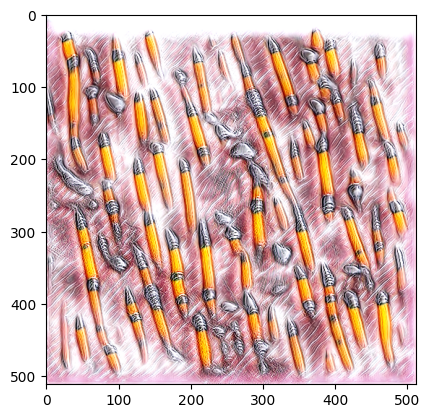

After 100 iters:
Total loss:  6662.11572265625
Content loss:  -0.07167915254831314
patch loss:  0.70703125
dir loss:  0.6162109375
TV loss:  0.8674389719963074
prompt : fire


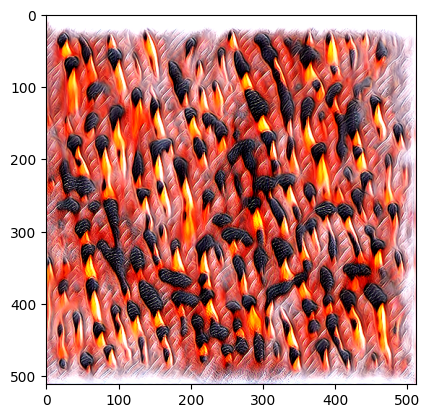

After 100 iters:
Total loss:  2688.45263671875
Content loss:  -0.18664708733558655
patch loss:  0.266357421875
dir loss:  0.634765625
TV loss:  0.9498060941696167
prompt : neon light


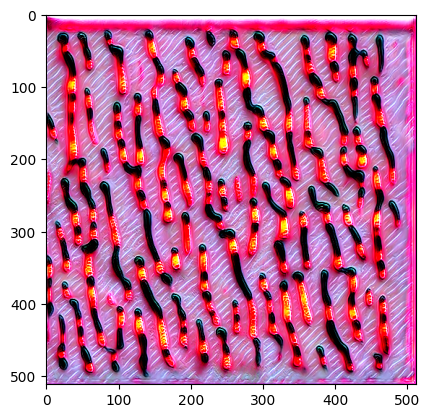

After 100 iters:
Total loss:  4713.45263671875
Content loss:  -0.19934627413749695
patch loss:  0.4912109375
dir loss:  0.64453125
TV loss:  1.104583501815796
prompt : pop themed nightlife


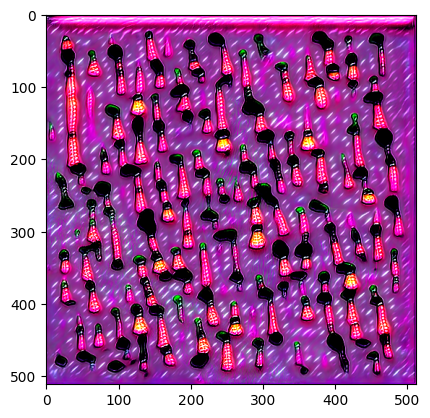

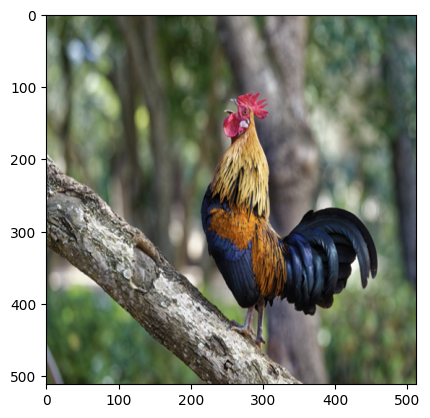

--------------------------

After 100 iters:
Total loss:  6219.712890625
Content loss:  -0.142164409160614
patch loss:  0.6552734375
dir loss:  0.6884765625
TV loss:  0.7873735427856445
prompt : pencil Sketch


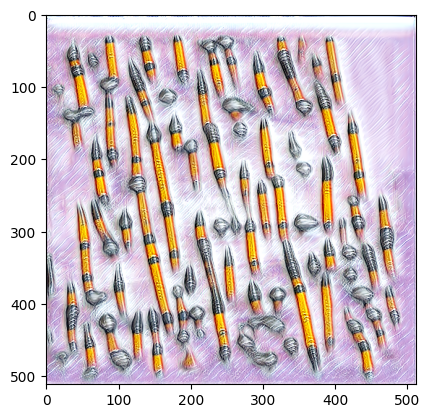

After 100 iters:
Total loss:  6856.44921875
Content loss:  -0.10411760210990906
patch loss:  0.72802734375
dir loss:  0.638671875
TV loss:  0.8168788552284241
prompt : fire


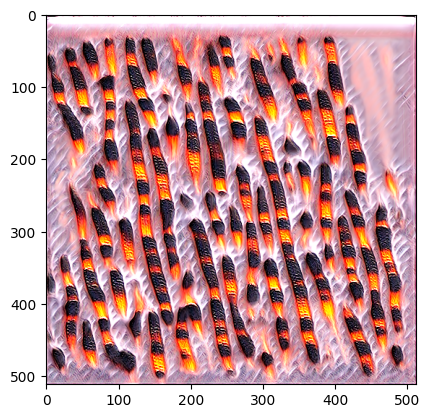

After 100 iters:
Total loss:  6984.96142578125
Content loss:  -0.18201003968715668
patch loss:  0.7431640625
dir loss:  0.64697265625
TV loss:  0.7626940608024597
prompt : neon light


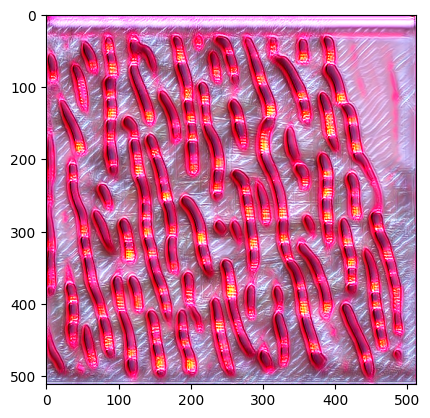

After 100 iters:
Total loss:  6949.06591796875
Content loss:  -0.2130831629037857
patch loss:  0.73828125
dir loss:  0.671875
TV loss:  1.0281902551651
prompt : pop themed nightlife


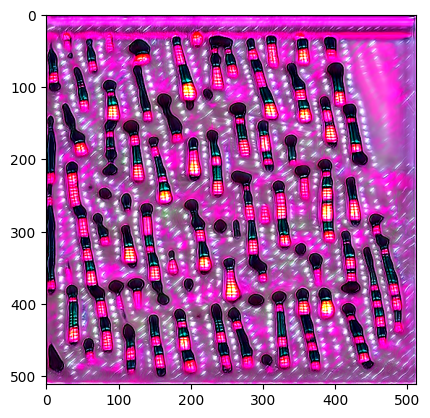

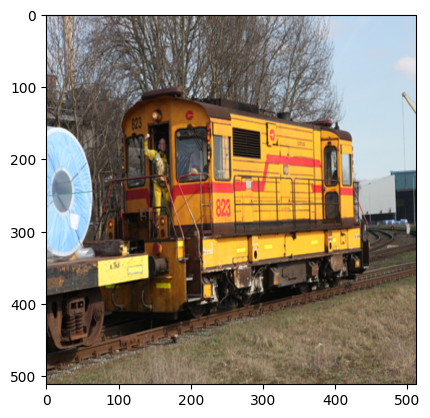

--------------------------

After 100 iters:
Total loss:  7486.3798828125
Content loss:  -0.08658262342214584
patch loss:  0.79150390625
dir loss:  0.7490234375
TV loss:  0.8671558499336243
prompt : pencil Sketch


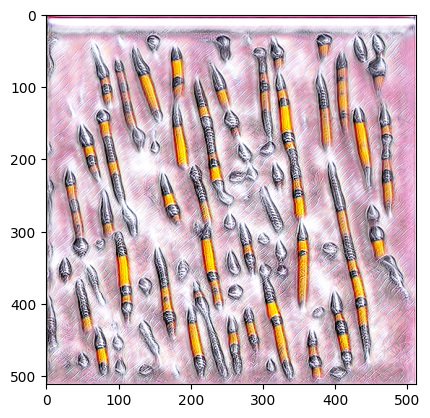

After 100 iters:
Total loss:  640.1959228515625
Content loss:  -0.07447117567062378
patch loss:  0.04400634765625
dir loss:  0.5087890625
TV loss:  0.9916086792945862
prompt : fire


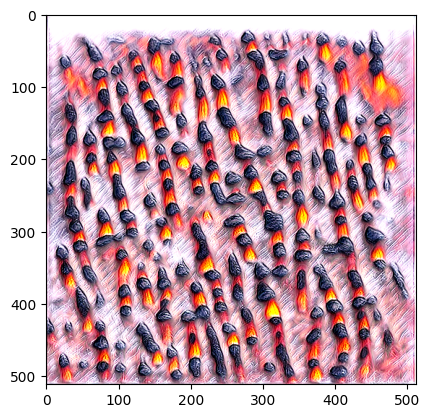

After 100 iters:
Total loss:  2069.2119140625
Content loss:  -0.10970452427864075
patch loss:  0.200439453125
dir loss:  0.5615234375
TV loss:  0.917604923248291
prompt : neon light


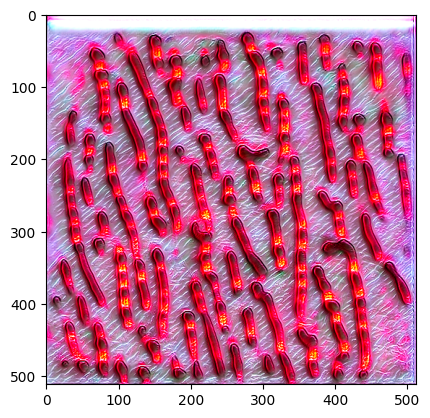

After 100 iters:
Total loss:  3160.6982421875
Content loss:  -0.13253092765808105
patch loss:  0.32177734375
dir loss:  0.56689453125
TV loss:  1.0777840614318848
prompt : pop themed nightlife


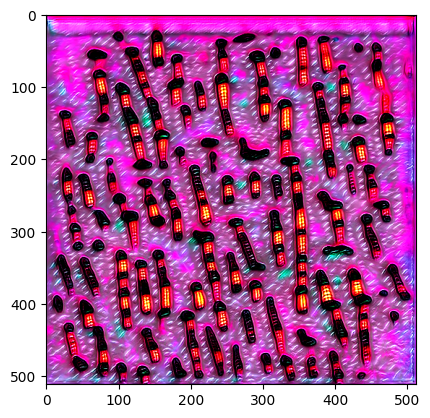

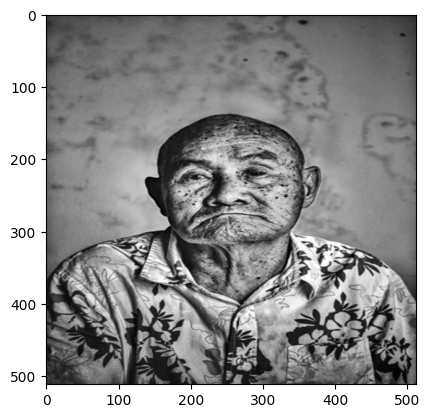

--------------------------

After 100 iters:
Total loss:  5217.30126953125
Content loss:  -0.16384245455265045
patch loss:  0.546875
dir loss:  0.64208984375
TV loss:  0.8772318363189697
prompt : pencil Sketch


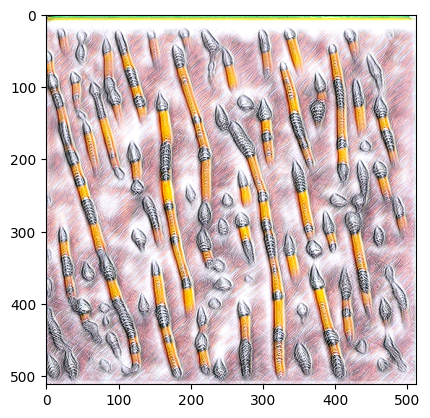

After 100 iters:
Total loss:  6689.94140625
Content loss:  -0.10199862718582153
patch loss:  0.71044921875
dir loss:  0.61669921875
TV loss:  0.9911277294158936
prompt : fire


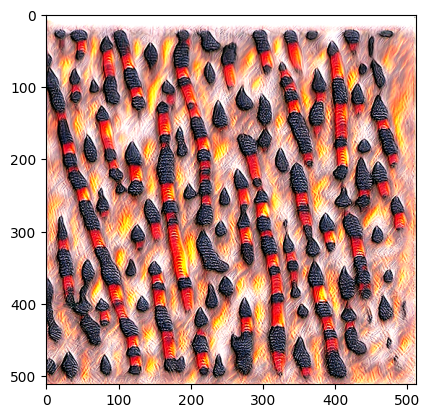

After 100 iters:
Total loss:  5480.2294921875
Content loss:  -0.1929282546043396
patch loss:  0.5771484375
dir loss:  0.625
TV loss:  0.6690236926078796
prompt : neon light


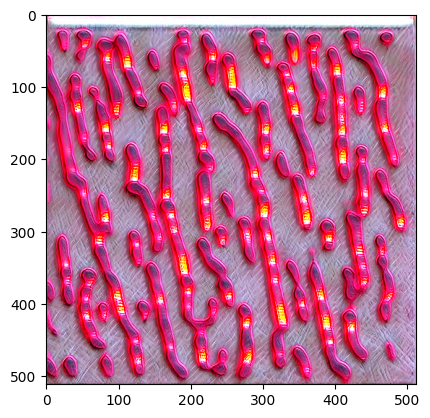

After 100 iters:
Total loss:  2158.05419921875
Content loss:  -0.2980712354183197
patch loss:  0.2108154296875
dir loss:  0.609375
TV loss:  1.0147188901901245
prompt : pop themed nightlife


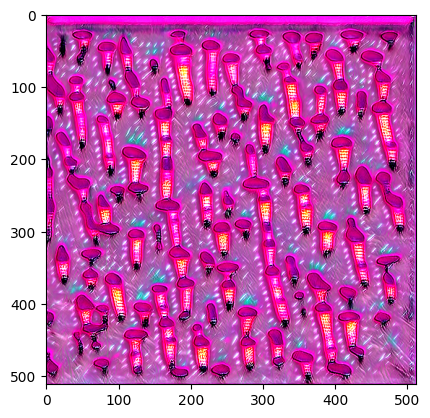

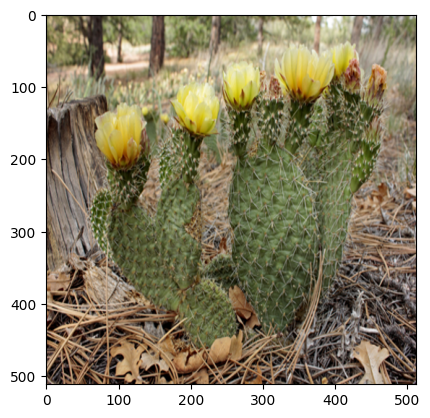

--------------------------

After 100 iters:
Total loss:  6055.876953125
Content loss:  -0.1694851815700531
patch loss:  0.63818359375
dir loss:  0.6728515625
TV loss:  0.7997264862060547
prompt : pencil Sketch


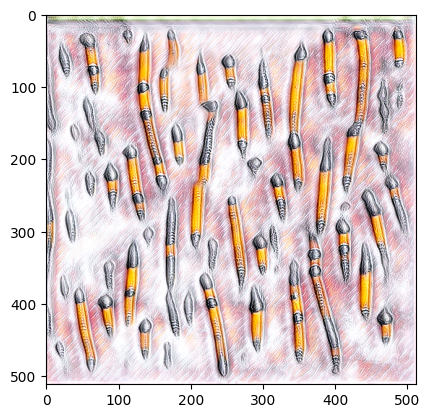

After 100 iters:
Total loss:  6470.2431640625
Content loss:  -0.11435888707637787
patch loss:  0.68603515625
dir loss:  0.62109375
TV loss:  0.8972079157829285
prompt : fire


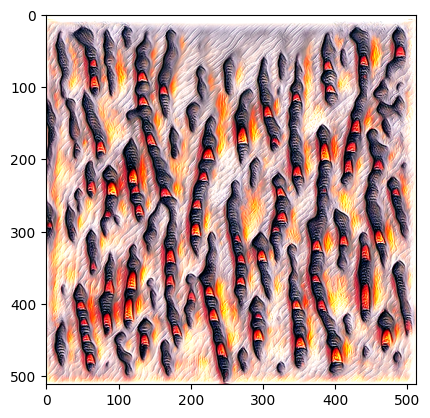

After 100 iters:
Total loss:  1275.69677734375
Content loss:  -0.25678277015686035
patch loss:  0.11077880859375
dir loss:  0.6328125
TV loss:  0.7140867710113525
prompt : neon light


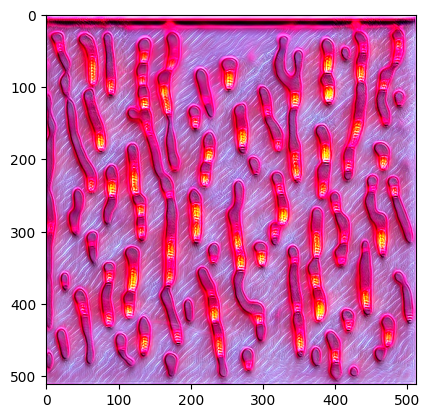

After 100 iters:
Total loss:  2442.510986328125
Content loss:  -0.3496829569339752
patch loss:  0.2442626953125
dir loss:  0.591796875
TV loss:  0.9633210897445679
prompt : pop themed nightlife


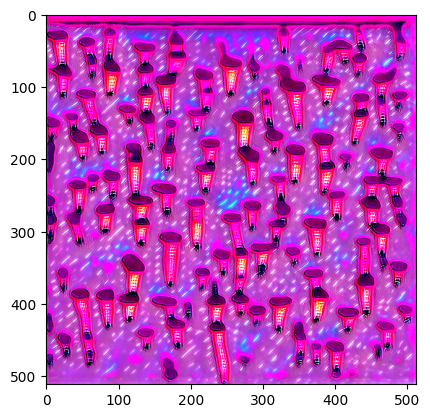

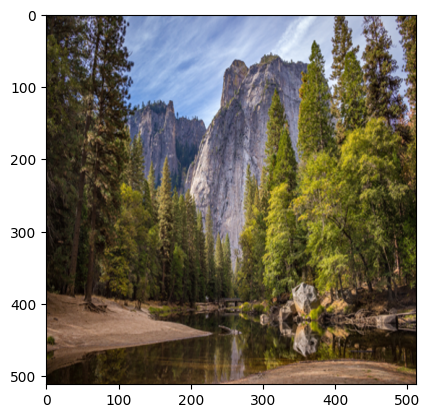

--------------------------

After 100 iters:
Total loss:  6960.619140625
Content loss:  -0.045092616230249405
patch loss:  0.734375
dir loss:  0.716796875
TV loss:  0.882810652256012
prompt : pencil Sketch


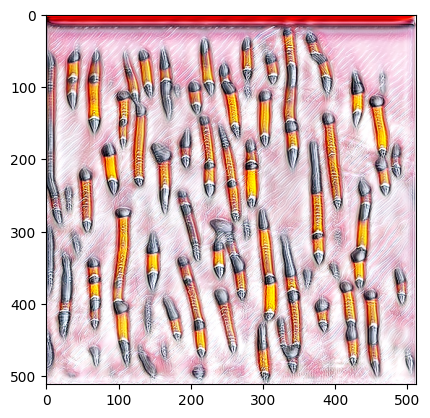

After 100 iters:
Total loss:  6988.11865234375
Content loss:  0.003996454179286957
patch loss:  0.73876953125
dir loss:  0.6767578125
TV loss:  1.0189871788024902
prompt : fire


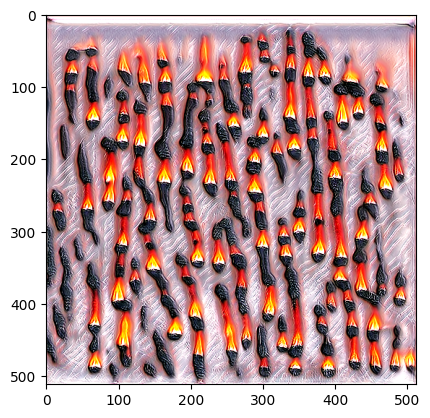

After 100 iters:
Total loss:  4808.67333984375
Content loss:  -0.0819036141037941
patch loss:  0.49951171875
dir loss:  0.64794921875
TV loss:  0.9591585993766785
prompt : neon light


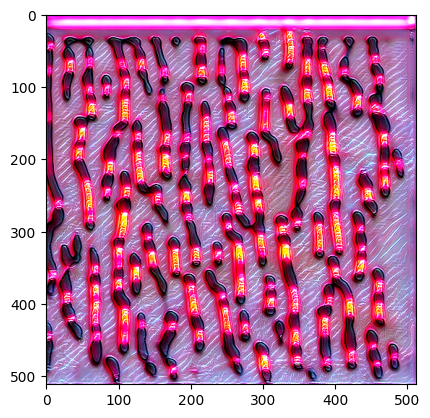

After 100 iters:
Total loss:  7201.41943359375
Content loss:  -0.10758953541517258
patch loss:  0.7607421875
dir loss:  0.73681640625
TV loss:  1.0581573247909546
prompt : pop themed nightlife


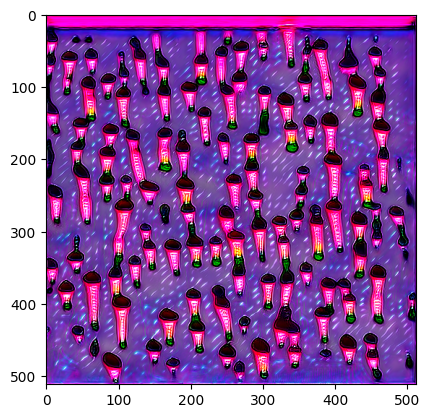

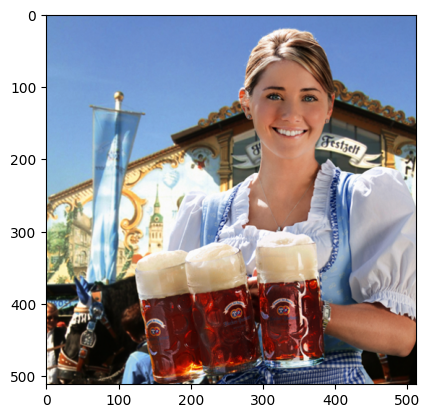

--------------------------

After 100 iters:
Total loss:  5143.83544921875
Content loss:  -0.08088899403810501
patch loss:  0.5361328125
dir loss:  0.662109375
TV loss:  0.968644917011261
prompt : pencil Sketch


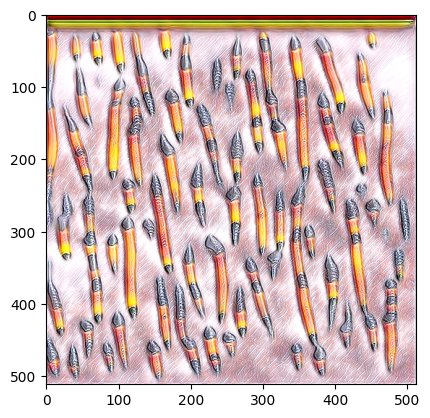

After 100 iters:
Total loss:  5935.22607421875
Content loss:  -0.028031764551997185
patch loss:  0.6259765625
dir loss:  0.6123046875
TV loss:  1.180724024772644
prompt : fire


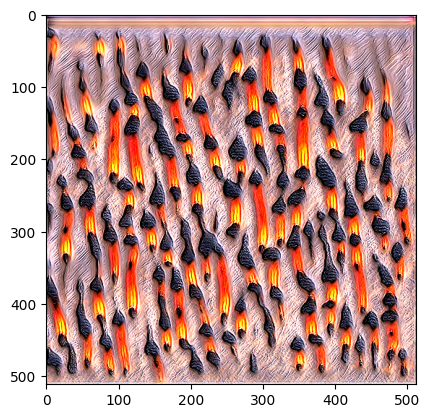

After 100 iters:
Total loss:  5441.44091796875
Content loss:  -0.09478936344385147
patch loss:  0.56982421875
dir loss:  0.6533203125
TV loss:  0.9090623259544373
prompt : neon light


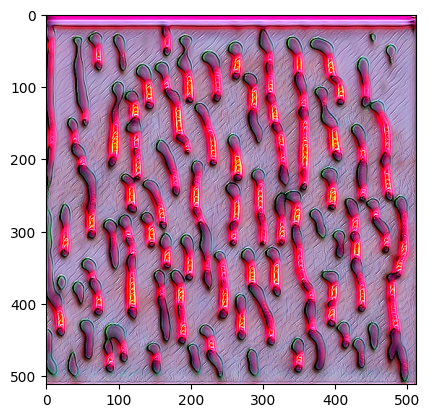

After 100 iters:
Total loss:  2404.496337890625
Content loss:  -0.25938907265663147
patch loss:  0.236572265625
dir loss:  0.625
TV loss:  0.9049033522605896
prompt : pop themed nightlife


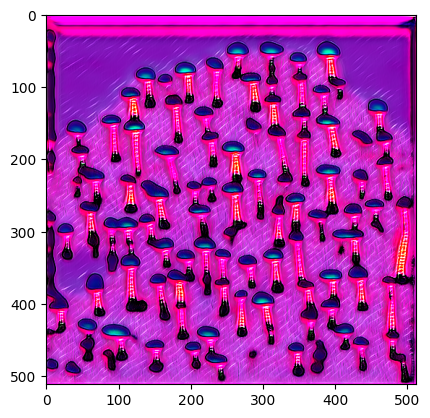

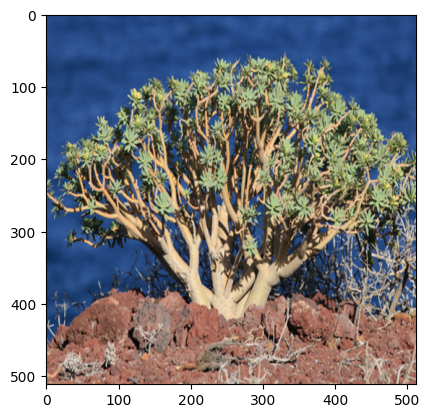

--------------------------

After 100 iters:
Total loss:  3359.822509765625
Content loss:  -0.27351751923561096
patch loss:  0.34326171875
dir loss:  0.6201171875
TV loss:  0.850172758102417
prompt : pencil Sketch


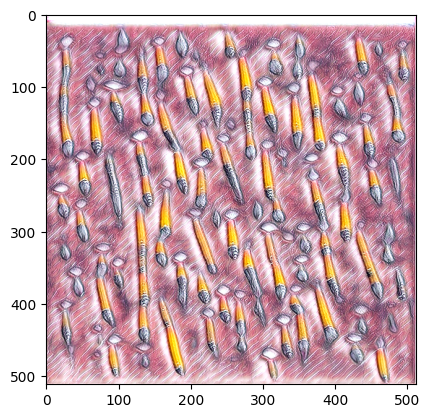

After 100 iters:
Total loss:  830.2215576171875
Content loss:  -0.25699079036712646
patch loss:  0.06622314453125
dir loss:  0.54345703125
TV loss:  1.0202172994613647
prompt : fire


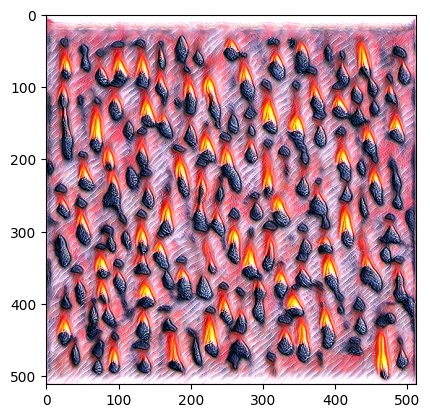

After 100 iters:
Total loss:  6156.48095703125
Content loss:  -0.28789421916007996
patch loss:  0.65087890625
dir loss:  0.685546875
TV loss:  0.9148215055465698
prompt : neon light


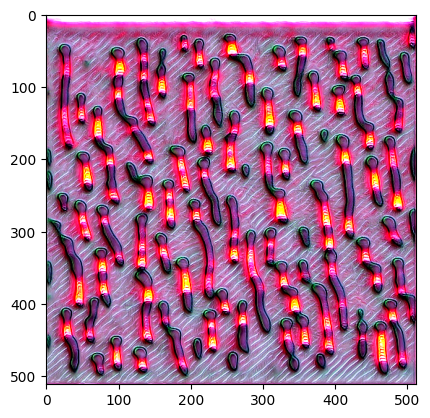

After 100 iters:
Total loss:  2147.122314453125
Content loss:  -0.38777998089790344
patch loss:  0.2115478515625
dir loss:  0.6005859375
TV loss:  1.0393364429473877
prompt : pop themed nightlife


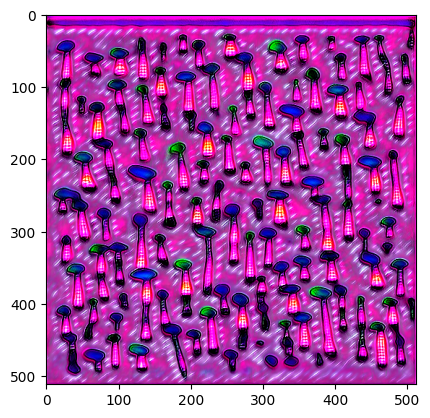

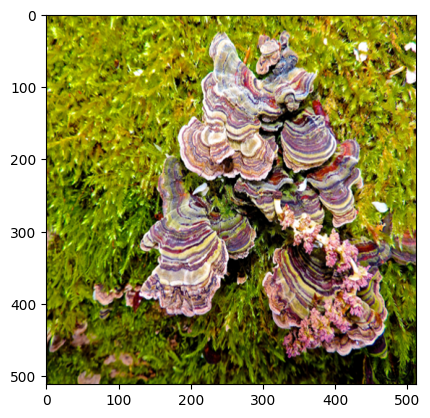

--------------------------

After 100 iters:
Total loss:  4939.8330078125
Content loss:  -0.0205803494900465
patch loss:  0.51220703125
dir loss:  0.66796875
TV loss:  0.9198875427246094
prompt : pencil Sketch


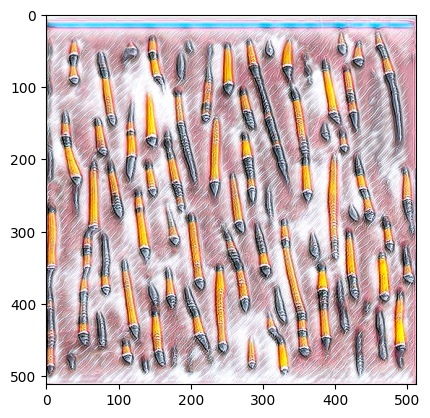

After 100 iters:
Total loss:  5837.37841796875
Content loss:  0.013953638263046741
patch loss:  0.61328125
dir loss:  0.62890625
TV loss:  0.7849790453910828
prompt : fire


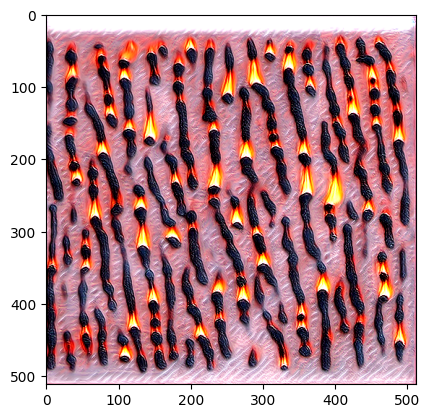

After 100 iters:
Total loss:  780.21630859375
Content loss:  -0.07114113867282867
patch loss:  0.05548095703125
dir loss:  0.58154296875
TV loss:  0.887462317943573
prompt : neon light


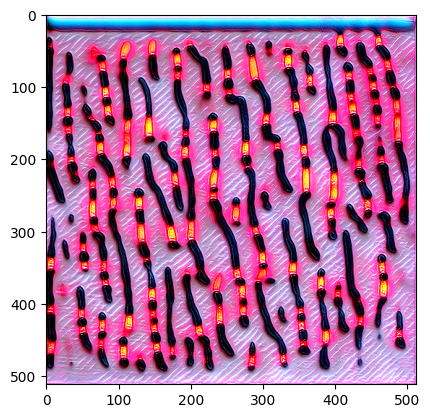

After 100 iters:
Total loss:  1674.7445068359375
Content loss:  -0.1752227395772934
patch loss:  0.1553955078125
dir loss:  0.6015625
TV loss:  1.2780110836029053
prompt : pop themed nightlife


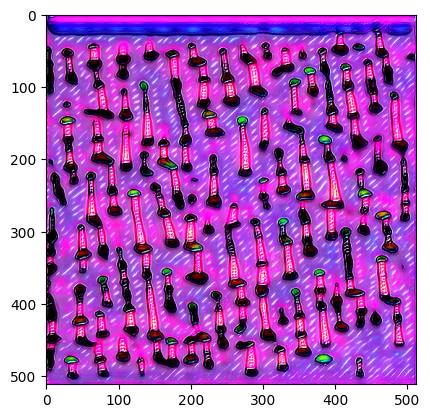

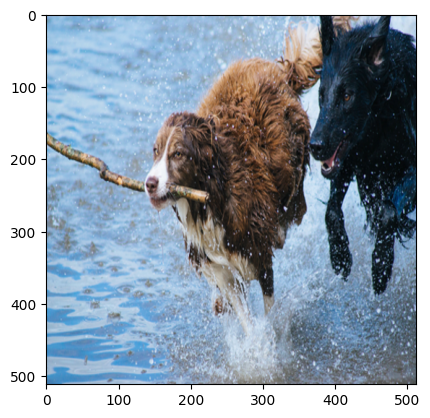

--------------------------

After 100 iters:
Total loss:  7112.75390625
Content loss:  -0.1422578990459442
patch loss:  0.75244140625
dir loss:  0.72265625
TV loss:  0.8427388072013855
prompt : pencil Sketch


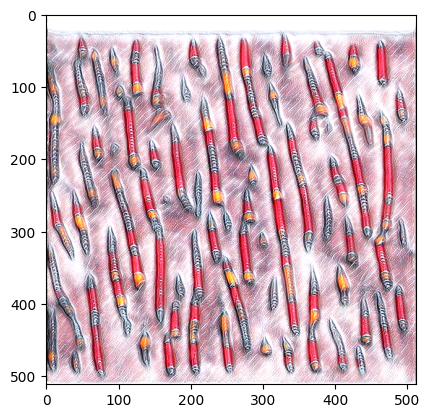

After 100 iters:
Total loss:  4497.99609375
Content loss:  -0.08383159339427948
patch loss:  0.468017578125
dir loss:  0.595703125
TV loss:  0.8208789229393005
prompt : fire


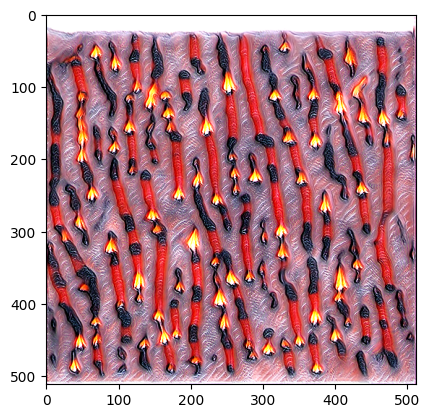

After 100 iters:
Total loss:  5050.49560546875
Content loss:  -0.14027531445026398
patch loss:  0.52978515625
dir loss:  0.60546875
TV loss:  0.7868770956993103
prompt : neon light
Buffered data was truncated after reaching the output size limit.

In [11]:
from IPython.display import display
from argparse import Namespace

source = "a Photo"

text = [ "pencil Sketch", "fire", "neon light", "pop themed nightlife"]
crop_size = 128

style_net = StyleNet.UNet()
style_net.to(device)

style_weights = {'conv1_1': 0.1,
                'conv2_1': 0.2,
                'conv3_1': 0.4,
                'conv4_1': 0.8,
                'conv5_1': 1.6}


clip_model, preprocess = clip.load('ViT-B/32', device, jit=False)
for i in jpg_files:
  for j in text:

    image_dir = "./train_data/" + i


    training_iterations = 100
    training_args = {
        "lambda_tv": 2e-3,
        "lambda_patch": 9000,
        "lambda_dir": 500,
        "lambda_c": 150,
        "crop_size": 128,
        "num_crops":64,
        "img_height":512,
        "img_width":512,
        "max_step":training_iterations,
        "lr":5e-4,
        "thresh":0.7,
        "content_path":image_dir,
        "text":text
    }

    args = Namespace(**training_args)

    def compose_text_with_templates(text: str, templates=imagenet_templates) -> list:
        return [template.format(text) for template in templates]

    content_path = args.content_path
    content_image = utils.load_image2(content_path, img_height=args.img_height,img_width =args.img_width)

    content_image = content_image.to(device)

    content_features = utils.get_features(img_normalize(content_image), resnet152)

    target = content_image.clone().requires_grad_(True).to(device)


    content_weight = args.lambda_c

    show_every = 100
    optimizer = optim.Adam(style_net.parameters(), lr=args.lr)
    scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=100, gamma=0.5)
    steps = args.max_step

    content_loss_epoch = []
    style_loss_epoch = []
    total_loss_epoch = []

    output_image = content_image

    m_cont = torch.mean(content_image,dim=(2,3),keepdim=False).squeeze(0)
    m_cont = [m_cont[0].item(),m_cont[1].item(),m_cont[2].item()]

    cropper = transforms.Compose([
        transforms.RandomCrop(args.crop_size)
    ])
    augment = transforms.Compose([
        transforms.RandomPerspective(fill=0, p=1,distortion_scale=0.5),
        transforms.Resize(224)
    ])


    prompt = j

    source = "a Photo"


    with torch.no_grad():
        template_text = compose_text_with_templates(prompt, imagenet_templates)
        tokens = clip.tokenize(template_text).to(device)
        text_features = clip_model.encode_text(tokens).detach()
        text_features = text_features.mean(axis=0, keepdim=True)
        text_features /= text_features.norm(dim=-1, keepdim=True)

        template_source = compose_text_with_templates(source, imagenet_templates)
        tokens_source = clip.tokenize(template_source).to(device)
        text_source = clip_model.encode_text(tokens_source).detach()
        text_source = text_source.mean(axis=0, keepdim=True)
        text_source /= text_source.norm(dim=-1, keepdim=True)
        source_features = clip_model.encode_image(clip_normalize(content_image,device))
        source_features /= (source_features.clone().norm(dim=-1, keepdim=True))


    num_crops = args.num_crops
    for epoch in range(0, steps+1):

        scheduler.step()
        target = style_net(content_image,use_sigmoid=True).to(device)
        target.requires_grad_(True)

        target_features = utils.get_features(img_normalize(target), resnet152)

        content_loss = 0
        content_loss += torch.mean((target_features['conv2_1'] - content_features['conv2_1']))
        content_loss += torch.mean((target_features['conv1_1'] - content_features['conv1_1']))

        loss_patch=0
        img_proc =[]
        for n in range(num_crops):
            target_crop = cropper(target)
            target_crop = augment(target_crop)
            img_proc.append(target_crop)

        img_proc = torch.cat(img_proc,dim=0)
        img_aug = img_proc

        image_features = clip_model.encode_image(clip_normalize(img_aug,device))
        image_features /= (image_features.clone().norm(dim=-1, keepdim=True))

        img_direction = (image_features-source_features)
        img_direction /= img_direction.clone().norm(dim=-1, keepdim=True)

        text_direction = (text_features-text_source).repeat(image_features.size(0),1)
        text_direction /= text_direction.norm(dim=-1, keepdim=True)
        loss_temp = (1- torch.cosine_similarity(img_direction, text_direction, dim=1))
        loss_temp[loss_temp<args.thresh] =0
        loss_patch+=loss_temp.mean()

        glob_features = clip_model.encode_image(clip_normalize(target,device))
        glob_features /= (glob_features.clone().norm(dim=-1, keepdim=True))

        glob_direction = (glob_features-source_features)
        glob_direction /= glob_direction.clone().norm(dim=-1, keepdim=True)

        loss_glob = (1- torch.cosine_similarity(glob_direction, text_direction, dim=1)).mean()

        reg_tv = args.lambda_tv*get_image_prior_losses(target)

        total_loss = args.lambda_patch*loss_patch + content_weight * content_loss+ reg_tv+ args.lambda_dir*loss_glob
        total_loss_epoch.append(total_loss)

        optimizer.zero_grad()
        total_loss.backward()
        optimizer.step()

        if epoch == 100:
            print("After %d iters:" % epoch)
            print('Total loss: ', total_loss.item())
            print('Content loss: ', content_loss.item())
            print('patch loss: ', loss_patch.item())
            print('dir loss: ', loss_glob.item())
            print('TV loss: ', reg_tv.item())

        if epoch == 100:
            print(f"prompt : {j}")
            output_image = target.clone()
            output_image = torch.clamp(output_image,0,1)
            output_image = adjust_contrast(output_image,1.5)
            plt.imshow(utils.im_convert2(output_image))
            plt.show()

  plt.imshow(utils.im_convert2(content_image))
  plt.show()
  print("--------------------------")
  print()


